# Simulating Orbits of the Solar System
- Victor Alvarado, cosmos@tamu.edu
- Ashlee Ballard, ashlee.ballard@tamu.edu
- Cade Ferry, cade.ferry@tamu.edu
- Lucas Samson, lsamson2004@tamu.edu


## Introduction

&nbsp; &nbsp; &nbsp; &nbsp; Our team, #Sbussin, decided to attempt to make our best simulation of the eight planets in the solar system. We agreed upon the idea as we believed it would challenge our coding skills in mathematical computation, proper plotting, and animation. Our goal is to achieve an animation consisting of the orbits of the eight planets in the solar system, accurate to their proper paths and comparative distance, as well as from the sun and each other. We find it interesting as it proposes the challenge of having multiple elliptical orbits, as well as each body having its own orbital velocity. To conclude, we used the central force equation and Kepler's problem, as well as Eulers method to solve it numerically.

## Finding Equations

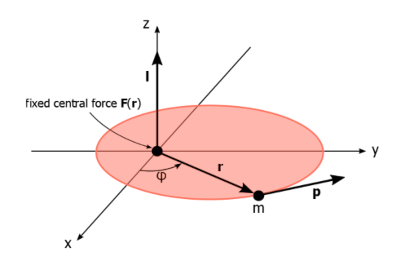 

_Figure 1: Example of the central force problem._





&nbsp; &nbsp; &nbsp; &nbsp; For each planet, there is a central force acting on it, which would be the Sun's gravity in this example. For this example, let us assume point $m$ is the planet in question. To calculate this force acting on point $m$, we used the central force equation.

$$\vec F = f(r)\hat r$$

Because $\hat r$, the unit vector of $\vec r,$ it can be written as follows:
$$\hat r = \frac{\vec r }{|r|}.$$

To calculte orbits of the planets, we will need to know the acceleration of the Sun's gravity acting on all of the planets. Using Newton's second law, which is $\vec F = m\vec a,$ we can write new equation as follows:
$$\vec a = \frac 1m \frac{f(r)}{r}\vec r.$$
To find $f(r),$ we used the equation from Kepler's Problem, which states that the magnitude of the force is proportional to the inverse square of the distance. This is the equation:
$$f(r) = \frac{-k}{r^2}$$
Where k is negative, plugging into the full equation, it is as follows:
$$\vec a = \frac{-k}{r^3}\vec r. $$



## Solving Numerically

&nbsp; &nbsp; &nbsp; &nbsp;To translate this equation into code, we used Euler's method. This method is a way solving differential equations numerially. It is a type of approximation which takes a linear approximation at some point, takes a small step foward, then takes another linear appoximation at that point, and so on.

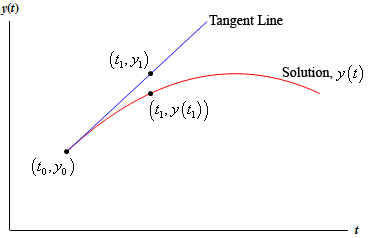

_Figure 2: Example of Euler's Method._

Here are the equations we used, where $x$ is the displacement, $v$ is the velocity, $a$ is the acceleration, and $dt$ is the time interval.

$$t_{new} = dt + t_{o}$$
$$v_{new} = v_{o} + a*dt$$
$$x_{new} = x_{o} + v*dt$$

$dt$ is the difference in $t$ values. If $dt$ is infinetely small, then the $x$ and $v$ values would be completely accurate. However, the computer would take an infinite amount of time to compute it. Because of this, we used a small enough $dt$ value to accurately simulate the system, but not small enough for it to take a large amount of time. Now the class and function will be made to simulate the planets motion.

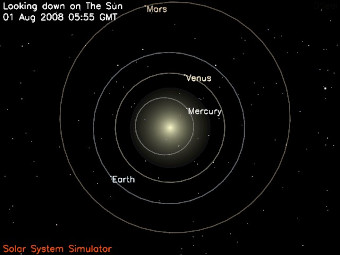

_Figure 3: Example of inner planet's orbits._

&nbsp; &nbsp; &nbsp; &nbsp;Below we imported all the packages nessesary to run all our required graphs, functions and animations. We made a `Planet` class which defined the motionary components of a planet while also updating the components of the planets through time and recording the position of the planet as it moves. The `Planet` class is very similar to the `Ball` class used in class, except with the `giveOutput()` function, which gives arrays for the x and y values of the planet. We also defined an `orbitalMotion()` function that records the motion of the plants onto the graph. We also made a parametric function which takes two functions, an x and y function, and the maximun t-value, and the amount of steps to take. This function returns a x-list and a y-list for a parametric function.

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.animation as animation
import IPython

class Planet(): #Defining the planet object
  def __init__(self,x,v,t=0,a=0): #defining all of the parts of the planet object
      self.x=np.array(x)
      self.v=np.array(v)
      self.a=np.array(a)
      self.t=t
      self.time_list=[]
      self.pos_list=[]
  def step(self,dt): #this function updates the position, velocity, and time by dt
      self.t=self.t+dt
      self.v=self.v+self.a*dt
      self.x=self.x+self.v*dt
  def rec(self): #this function records the x, and t to the time and position lists
      self.time_list.append(self.t)
      self.pos_list.append(self.x)
  def giveOutput(self): #this function give 2 lits as outputs splitting the position list into x and y values.
      x_pos = np.array(self.pos_list)[:,0]
      y_pos = np.array(self.pos_list)[:,1]
      return x_pos, y_pos

def orbitalMotion(Planet,tmax,num_step,f_a=lambda x,v,t:0): #this function uses the step and record functions to record the orbital motion of the graph
  dt = tmax/num_step
  for i in range(num_step):
    Planet.a = f_a(Planet.x,Planet.v,Planet.t)
    Planet.step(dt)
    Planet.rec()

def para(x,y,t_max,num_step): #this function is for making lists to graph parameteric function
    dt = t_max/num_step
    x_list = [x(0)]
    y_list = [y(0)]
    t = 0
    for i in range(num_step):
        t += dt
        xn = x(t)
        yn = y(t)
        x_list.append(xn)
        y_list.append(yn)
    return x_list,y_list




## Simulating the First Planet

&nbsp; &nbsp; &nbsp; &nbsp;  For this first example, we defined this planet as having one distance from the center, and one velocity. This yeilded a stable orbit when the $k$ constant was $-1$ as seen below.

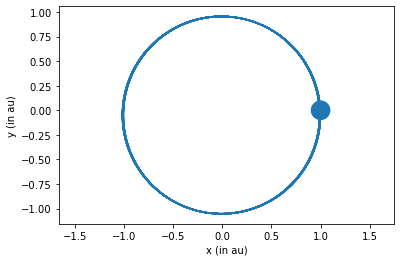

In [2]:
#define planet object
E = Planet(x=(1,0),v=(0,1))

#use orbital motion function, and use the equation above for the acceleration
orbitalMotion(tmax = 100, num_step = 1000, Planet=E, f_a = lambda x,v,t: -1/(np.linalg.norm(x)**3)*x)

#call on giveOutput() function to give x and y arrays
posxe,posye = E.giveOutput()

# set up the plot
tfig,tax = plt.subplots()
tax.axis('equal')
tax.set_ylabel('y (in au)')
tax.set_xlabel('x (in au)')

#add a circle as the object
testplanet = plt.Circle((1,0),radius = 0.1)
tax.add_patch(testplanet)

#plot the first planet
tax.plot(posxe,posye)

&nbsp; &nbsp; &nbsp; &nbsp; Because Earth is approximately 1 astonomical unit away, we decided to base our units of simulation in AU, and to use this first example as Earth's orbit. Thus, astronomical units were used for the distance from the Sun for each planet. To find the velocities for other planets, we based the velocities off of a factor of Earth's velocity of 1. For example, Earth's orbital velocity is about 30km/s, while Mercury's velocity is about 47 km/s. Mercury's velocity is about 1.59x faster than Earth's veloctity, thus 1.590 was was used for Mercury's velocity. To summarize, the units used in this diagram are astronomical units, and the  velocity is based off of a factor of Earth's velocity.

&nbsp; &nbsp; &nbsp; &nbsp; Below, we define every planet using the planet class and inputting it's nessesary componants as a factor of Earth's. We then input each planet and it's components into the orbital motion function to have the motion of each planet. Since the outer planets take significantly longer to orbit and are very stretched out, we opted to make two graphs, one simulating the inner planets, and one for the outer planets. This is why the maximum time for the outer planets is over 10x that of the inner planets.

In [32]:
#Define each planet object
E = Planet(x=(1,0),v=(0,1))
V = Planet(x=(.723,0), v=(0,1.176))
M = Planet(x=(.39,0), v = (0,1.590))
Ma = Planet(x =(1.524,0), v = (0,.80))
Ju = Planet(x=(5.201,0), v=(0,0.439))
Sa = Planet(x=(9.575,0), v=(0,0.325))
Ur = Planet(x=(19.1555,0), v=(0,0.228))
Ne = Planet(x=(30.1824,0), v=(0,0.182))



#call the orbitalMotion() function for each object which will make an array of the position
orbitalMotion(tmax = 100, num_step = 2000, Planet=E, f_a = lambda x,v,t: -1/(np.linalg.norm(x)**3)*x) # given extra steps for the inner planets so they will have a stable orbit
orbitalMotion(tmax = 100, num_step = 2000, Planet=V, f_a = lambda x,v,t: -1/(np.linalg.norm(x)**3)*x)
orbitalMotion(tmax = 100, num_step = 2000, Planet=M, f_a = lambda x,v,t: -1/(np.linalg.norm(x)**3)*x)
orbitalMotion(tmax = 100, num_step = 2000, Planet=Ma, f_a = lambda x,v,t: -1/(np.linalg.norm(x)**3)*x)
orbitalMotion(tmax = 1042, num_step = 1042, Planet=Ju, f_a = lambda x,v,t: -1/(np.linalg.norm(x)**3)*x)
orbitalMotion(tmax = 1042, num_step = 1042, Planet=Sa, f_a = lambda x,v,t: -1/(np.linalg.norm(x)**3)*x)
orbitalMotion(tmax = 1042, num_step = 1042, Planet=Ur, f_a = lambda x,v,t: -1/(np.linalg.norm(x)**3)*x)
orbitalMotion(tmax = 1042, num_step = 1042, Planet=Ne, f_a = lambda x,v,t: -1/(np.linalg.norm(x)**3)*x)

&nbsp; &nbsp; &nbsp; &nbsp;We use the equation we derived earlier, $\vec a  = -\frac{k}{r^3}\vec r$. This problem was used to calculate the acceleration of the central force. This was plugged into the `orbitalMotion()` functions in the `f_a` variable. After this, the inner planets were graphed using the Matplotlib function.

<Figure size 2880x2880 with 0 Axes>

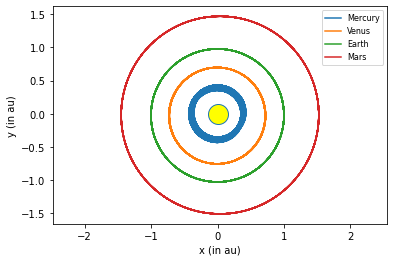

In [33]:
#use giveOutput() function on each planet to get the x and y values from the postion array 
pos_xE,pos_yE = E.giveOutput()
pos_xV,pos_yV = V.giveOutput()
pos_xM,pos_yM = M.giveOutput()
pos_xMa,pos_yMa = Ma.giveOutput()


#initialize graph
plt.figure(figsize=(40,40))
fig1,ax1=plt.subplots()
ax1.axis('equal')
ax1.axis('equal')
ax1.set_xlabel('x (in au)')
ax1.set_ylabel('y (in au)')


#plot graph
ax1.plot([0], [0], marker='o', markersize=20, markerfacecolor="yellow") # This is the Sun
ax1.plot(pos_xM,pos_yM, label='Mercury',color='tab:blue')
ax1.plot(pos_xV,pos_yV, label = 'Venus',color='tab:orange')
ax1.plot(pos_xE,pos_yE, label = 'Earth',color='tab:green')
ax1.plot(pos_xMa,pos_yMa, label = 'Mars',color='tab:red')

#add legend
ax1.legend(fontsize=8)

#add Circle objects 
Mercury = plt.Circle((0,0), radius=0.05, color='tab:blue')
Venus = plt.Circle((0,0), radius=0.1, color='tab:orange')
Earth = plt.Circle((0,0), radius=0.1, color='tab:green')
Mars = plt.Circle((0,0),radius = 0.075,color = 'tab:red')
ax1.add_patch(Mercury)
ax1.add_patch(Venus)
ax1.add_patch(Earth)
ax1.add_patch(Mars)

plt.show()

&nbsp; &nbsp; &nbsp; &nbsp;As seen from the  graph above, the orbit of Mercury and Venus is unstable after a certain amount of time. When adding the larger planets, and increasing the time interval, the following happens:

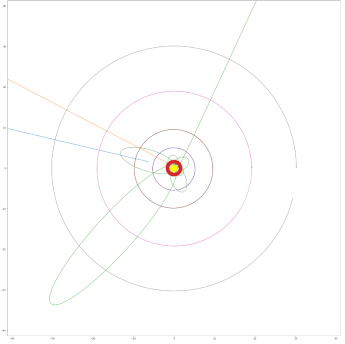

_Figure 4: Test run of the graph of the planets._

Because of this, we decided to use a parametric function to simulate the inner planets in the larger graph. To graph a circle that rotates counter-clockwise, these functions were used:
$$x = \cos{t}$$
$$y = \sin{t}.$$
&nbsp; &nbsp; &nbsp; &nbsp;To graph each planet, we changed the coefficient of the $y$ and $x$ functions to change the radius of said planet. The time of the function was put in as `num_step`, and to calculate `t_max` for the function, the amonut of revolutions of the planets were multiplied by $2\pi$. Here is an example of the `para` funciton.

In [34]:
#get output of the parametric functions, num_step matching the time of the other functions, and t_max being the rotations of the planets
xE2,yE2 = para(x=lambda x:np.cos(x),y=lambda x: np.sin(x),t_max= 330*np.pi,num_step=1042)
xV2,yV2 = para(x=lambda x:np.cos(x)*.723,y=lambda x:np.sin(x)*.723,t_max = 538*np.pi,num_step=1042)
xM2,yM2 = para(x=lambda x:np.cos(x)*.39,y=lambda x:np.sin(x)*.39,t_max = 1349*np.pi,num_step=1042)
xMa2,yMa2 = para(x=lambda x:np.cos(x)*1.522,y=lambda x:np.sin(x)*1.522,t_max = 176*np.pi,num_step=1042)

&nbsp; &nbsp; &nbsp; &nbsp;With the parametric functions being defined for the inner planets, the x and y lists for the outer planets are made and the full solar system graph is made. The outer planet's accelerations were made using the same techniques as earler.

&nbsp; &nbsp; &nbsp; &nbsp;Below, we utilized the Matplotlib module to graph the components of the planets. We used subplots so we can show two different graphs, one of the inner planets and one showcasing the gas giants. It allows us to have the lines and color of the planets universal.

<Figure size 2880x2880 with 0 Axes>

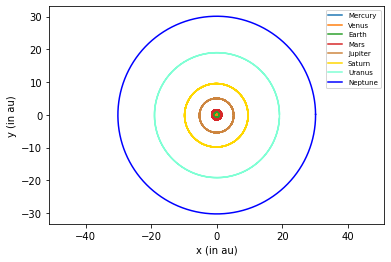

In [35]:
#get x and y values of the inner planets
pos_xJu,pos_yJu = Ju.giveOutput()
pos_xSa,pos_ySa = Sa.giveOutput()
pos_xUr,pos_yUr = Ur.giveOutput()
pos_xNe,pos_yNe = Ne.giveOutput()

#initialize graph
plt.figure(figsize=(40,40))
fig2,ax2=plt.subplots()
ax2.axis('equal')
ax2.set_xlabel('x (in au)')
ax2.set_ylabel('y (in au)')

#plot the componenets
ax2.plot(xM2,yM2,label = 'Mercury', color='tab:blue')
ax2.plot(xV2,yV2,label = 'Venus', color='tab:orange')
ax2.plot(xE2,yE2,label = 'Earth', color='tab:green')
ax2.plot(xMa2,yMa2,label = 'Mars',color='tab:red')
ax2.plot(pos_xJu,pos_yJu, label = 'Jupiter',color='peru')
ax2.plot(pos_xSa,pos_ySa, label = 'Saturn',color='gold')
ax2.plot(pos_xUr,pos_yUr, label = 'Uranus',color='aquamarine')
ax2.plot(pos_xNe,pos_yNe, label = 'Neptune',color='blue')

#add legend
ax2.legend(fontsize=7)

#add Circle objects to graph
Jupiter = plt.Circle((0,0),radius = 1,color = 'peru')
Saturn = plt.Circle((0,0),radius = 1,color = 'gold')
Uranus = plt.Circle((0,0),radius = 1,color = 'aquamarine')
Neptune = plt.Circle((0,0),radius = 1,color = 'blue')
Mercury2 = plt.Circle((0,0), radius=0.05, color='tab:blue')
Venus2 = plt.Circle((0,0), radius=0.1, color='tab:orange')
Earth2 = plt.Circle((0,0), radius=0.1, color='tab:green')
Mars2 = plt.Circle((0,0),radius = 0.075,color = 'tab:red')
ax2.add_patch(Mercury2)
ax2.add_patch(Venus2)
ax2.add_patch(Earth2)
ax2.add_patch(Mars2)
ax2.add_patch(Jupiter)
ax2.add_patch(Saturn)
ax2.add_patch(Uranus)
ax2.add_patch(Neptune)





plt.show()

Above is a graph illustating the orbits of all the planets in the solar system. As you can see, it is very difficult to make out the orbits of the inner planets. That is why we ultilized two seperate graphs.

To animate both of these graphs, we had to make two `draw_frame` functions. These functions, when plugged into the `FuncAnimation()` function in Matplotlib help animate the function. These functions graph each planet to the specified `frame_index`, then append the `Circle` for each planet to the correct position in the planet's orbit.

In [36]:
#define draw_frame function for inner planets graph
def draw_frame_small(frame_index):
    lines=ax1.get_lines()
    lines[1].set_data(pos_xM[0:frame_index],pos_yM[0:frame_index])
    Mercury.center = (pos_xM[frame_index], pos_yM[frame_index])
    lines[2].set_data(pos_xV[0:frame_index],pos_yV[0:frame_index])
    Venus.center = (pos_xV[frame_index], pos_yV[frame_index])
    lines[3].set_data(pos_xE[0:frame_index],pos_yE[0:frame_index])
    Earth.center = (pos_xE[frame_index], pos_yE[frame_index])
    lines[4].set_data(pos_xMa[0:frame_index],pos_yMa[0:frame_index])
    Mars.center = (pos_xMa[frame_index], pos_yMa[frame_index])
   
# define draw_frame function for full solar system
def draw_frame_bigscale(frame_index):
    frame_index = frame_index * 2
    lines = ax2.get_lines()
    lines[0].set_data(xM2[0:frame_index],yM2[0:frame_index])
    Mercury2.center = (xM2[frame_index], yM2[frame_index])
    lines[1].set_data(xV2[0:frame_index],yV2[0:frame_index])
    Venus2.center = (xV2[frame_index], yV2[frame_index])
    lines[2].set_data(xE2[0:frame_index],yE2[0:frame_index])
    Earth2.center = (xE2[frame_index], yE2[frame_index])
    lines[3].set_data(xMa2[0:frame_index],yMa2[0:frame_index])
    Mars2.center = (xMa2[frame_index], yMa2[frame_index])
    lines[4].set_data(pos_xJu[0:frame_index],pos_yJu[0:frame_index])
    Jupiter.center = (pos_xJu[frame_index], pos_yJu[frame_index])
    lines[5].set_data(pos_xSa[0:frame_index],pos_ySa[0:frame_index])
    Saturn.center = (pos_xSa[frame_index], pos_ySa[frame_index])
    lines[6].set_data(pos_xUr[0:frame_index],pos_yUr[0:frame_index])
    Uranus.center = (pos_xUr[frame_index], pos_yUr[frame_index])
    lines[7].set_data(pos_xNe[0:frame_index],pos_yNe[0:frame_index])
    Neptune.center = (pos_xNe[frame_index], pos_yNe[frame_index])

In [37]:
#full solar system animation
anim = animation.FuncAnimation(fig2, draw_frame_bigscale, frames=500, interval=10)
IPython.display.HTML(anim.to_jshtml())

In [38]:
#inner planets solar system animation
anim2 = animation.FuncAnimation(fig1,draw_frame_small,frames=500,interval = 25)
IPython.display.HTML(anim2.to_jshtml())

## Results and Conslusion
&nbsp; &nbsp; &nbsp; &nbsp; To summarize, the eight planets within our solar system presented a variety of challenges, including their elliptical orbits, orbital velocities, distances from the sun, and distance from each other. The two animations presented demonstrate these qualities, with the two using differing scales. Since the inner planets can be difficult to visualize on the scale of the outer gas giants, we decided to simulate two different animations to properly display the orbits of the planets. The additional aspect of orbital velocities proposes another reason, as planets such as Mercury orbit very quickly around the sun, taking only 88 days, while Neptune on the far reaches takes 165 years. This is another reason why we decided to split the inner planets from the total solar system. All in all, our simulation properly displays the accurate orbits and speeds of the planets, just with separate orbits to better understand the difference in scale between the inner and outer planets.


&nbsp; &nbsp; &nbsp; &nbsp;We were able to simulate the orbits of the eight planets as similar to the real thing as we could. When looking at pictures of the actual orbits and comparing them to our simulation, you will find that the spacing between the planets is to scale and the speed is similar to the actual speeds of the planets. We as a group learned how to create a scale for the planets by using information provided by NASA and how to work through the issues we faced, like unstable orbits. We had to learn how to make the orbits of the inner planets stable. In the end, though, we got it to work and act like the actual solar system. 

## References

- “Planets.” NASA, NASA, 14 July 2021, https://solarsystem.nasa.gov/planets/overview/. 
- Williams, D. R. Mercury fact sheet. NASA. Retrieved December 9, 2022, from https://nssdc.gsfc.nasa.gov/planetary/factsheet/mercuryfact.html 
- Williams, D. R. Venus fact sheet. NASA. Retrieved December 9, 2022, from https://nssdc.gsfc.nasa.gov/planetary/factsheet/venusfact.html
-  Williams, D. R. Mars fact sheet. NASA. Retrieved December 9, 2022, from https://nssdc.gsfc.nasa.gov/planetary/factsheet/marsfact.html
- Williams, D. R. Jupiter fact sheet. NASA. Retrieved December 9, 2022, from https://nssdc.gsfc.nasa.gov/planetary/factsheet/jupiterfact.html
- Williams, D. R. Saturn fact sheet. NASA. Retrieved December 9, 2022, from https://nssdc.gsfc.nasa.gov/planetary/factsheet/saturnfact.html
- Williams, D. R. Uranus fact sheet. NASA. Retrieved December 9, 2022, from https://nssdc.gsfc.nasa.gov/planetary/factsheet/uranusfact.html
- Williams, D. R. Neptune fact sheet. NASA. Retrieved December 9, 2022, from https://nssdc.gsfc.nasa.gov/planetary/factsheet/neptunefact.html
- Dawkins, P. (2022, November 22). Section 2.9 : Euler's Method. Differential equations - euler's method. Retrieved December 9, 2022, from https://tutorial.math.lamar.edu/classes/de/eulersmethod.aspx 
- Matplotlib Development Team. (n.d.). Pyplot tutorial. Pyplot tutorial - Matplotlib 3.6.2 documentation. Retrieved December 9, 2022, from https://matplotlib.org/stable/tutorials/introductory/pyplot.html 
- Dourmashkin, P. (2020, December 30). 25.1: Introduction- the kepler problem. Physics LibreTexts. Retrieved December 9, 2022, from https://phys.libretexts.org/Bookshelves/Classical_Mechanics/Classical_Mechanics_(Dourmashkin)/25:_Celestial_Mechanics/25.01:_Introduction-_The_Kepler_Problem 
- BYJU'S. (2022, August 31). What is Central Force - equations, examples, fields and faqs. BYJUS. Retrieved December 9, 2022, from https://byjus.com/physics/central-force/ 


## Group Contributions
- Lucas: Making the main Class and functions used, and designing graphs. I also made the comments on the code and helped explain the code.
- Ashlee: Messed around with the code and helped with the placements of the planets and sun.
- Cade: Putting together the lab report along with the references used in the project.
- Victor: Gathered information on the planets' characteristics and put them as a factor of Earth.